In [2]:
from datasets import load_dataset

ds = load_dataset("benjamin-paine/free-music-archive-small")

In [1]:
import torch
from torch.utils.data import DataLoader, Dataset
import torchaudio
import numpy as np

import torchaudio.transforms as T

class AudioDataset(Dataset):
  def __init__(self, dataset, transform=None):
    self.dataset = dataset
    self.transform = transform
  
  def __len__(self):
    return len(self.dataset)
  
  def __getitem__(self, idx):
    item = self.dataset[idx]
    audio_data = item['audio']
    
    # Convert to torch tensor
    waveform = torch.tensor(audio_data['array'], dtype=torch.float32)
    sample_rate = audio_data['sampling_rate']
    
    # Apply transforms if provided
    if self.transform:
      waveform = self.transform(waveform)
    
    # Get genres as labels (convert to tensor)
    genres = item['genres'] if item['genres'] else []
    
    return {
      'audio': waveform,
      'genres': genres,
      'title': item['title'],
      'artist': item['artist']
    }

# Define audio augmentations
audio_transforms = torch.nn.Sequential(
  T.TimeStretch(hop_length=None, n_freq=201, fixed_rate=None),
  T.FrequencyMasking(freq_mask_param=30),
  T.TimeMasking(time_mask_param=40),
  T.Vol(gain=0.1),  # Volume adjustment
)

# Create dataset and dataloader
train_dataset = AudioDataset(ds['train'], transform=audio_transforms)
train_dataloader = DataLoader(
  train_dataset,
  batch_size=16,
  shuffle=True,
  num_workers=2,
  collate_fn=lambda batch: {
    'audio': [item['audio'] for item in batch],
    'genres': [item['genres'] for item in batch],
    'title': [item['title'] for item in batch],
    'artist': [item['artist'] for item in batch]
  }
)

ModuleNotFoundError: No module named 'torchaudio'

In [3]:
ds

DatasetDict({
    train: Dataset({
        features: ['audio', 'title', 'url', 'artist', 'composer', 'lyricist', 'publisher', 'genres', 'tags', 'released', 'language', 'listens', 'artist_url', 'artist_website', 'album_title', 'album_url', 'license', 'copyright', 'explicit', 'instrumental', 'allow_commercial_use', 'allow_derivatives', 'require_attribution', 'require_share_alike'],
        num_rows: 7916
    })
})

In [4]:
unique_genres = set()
for item in ds['train']['genres']:
  if item:  # Check if genres is not None or empty
    unique_genres.update(item)

len(unique_genres)

114

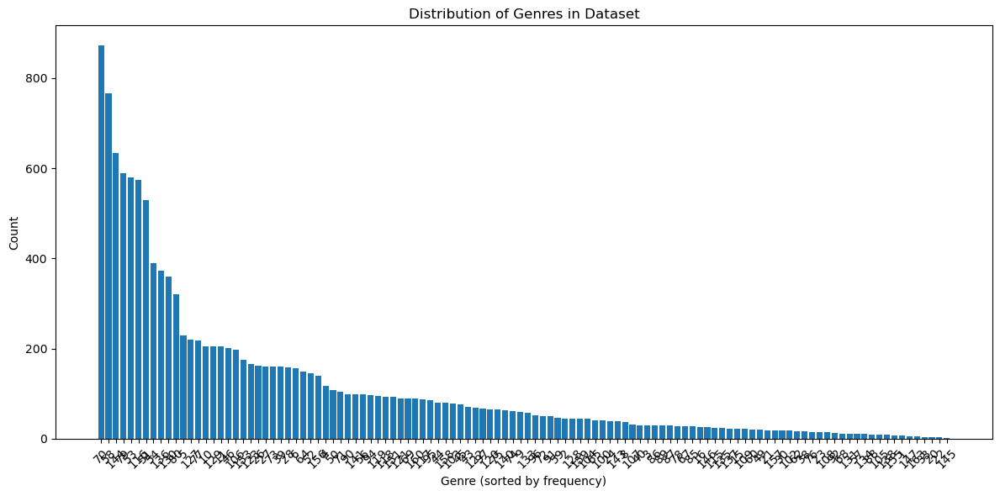

In [11]:
from collections import Counter

import matplotlib.pyplot as plt

# Count occurrences of each genre
genre_counts = Counter()
for item in ds['train']['genres']:
  if item:  # Check if genres is not None or empty
    for genre in item:
      genre_counts[genre] += 1

# Sort genres by count in descending order
sorted_genres = sorted(genre_counts.items(), key=lambda x: x[1], reverse=True)
genres, counts = zip(*sorted_genres)

# Create histogram
plt.figure(figsize=(12, 6))
plt.bar(range(len(genres)), counts)
plt.xlabel('Genre (sorted by frequency)')
plt.ylabel('Count')
plt.title('Distribution of Genres in Dataset')
plt.xticks(range(len(genres)), genres, rotation=45)
plt.tight_layout()
plt.show()

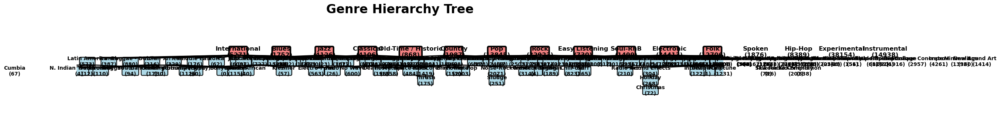

In [22]:
import networkx as nx

# Create a hierarchical layout using graphviz_layout or manually position nodes by levels
# Find root nodes (nodes with no parents)
root_nodes = [node for node in G.nodes() if G.in_degree(node) == 0]

# Create levels dictionary to organize nodes by hierarchy
levels = defaultdict(list)

def assign_levels(node, level=0):
  levels[level].append(node)
  for child in G.successors(node):
    assign_levels(child, level + 1)

# Assign levels starting from root nodes
for root in root_nodes:
  assign_levels(root)

# Create manual positions for tree layout
pos = {}
max_level = max(levels.keys()) if levels else 0

# Calculate the maximum width needed based on the level with most nodes
max_nodes_per_level = max(len(nodes) for nodes in levels.values())
figure_width = max(24, max_nodes_per_level * 3)  # Minimum 24, or 3 units per node

for level, nodes in levels.items():
  y_pos = max_level - level  # Higher levels at top
  # Adjust spacing based on figure width and number of nodes
  x_spacing = figure_width / max(len(nodes), 1)
  
  for i, node in enumerate(nodes):
    x_pos = (i - len(nodes)/2) * x_spacing
    pos[node] = (x_pos, y_pos)

# Create a larger figure for better visibility
plt.figure(figsize=(figure_width, 18), dpi=300)

# Draw the tree
nx.draw(G, pos, 
    with_labels=True, 
    labels={node: G.nodes[node]['label'] for node in G.nodes()},
    node_color='lightblue',
    node_size=1500,  # Slightly smaller nodes to fit better
    font_size=5,     # Smaller font to fit in nodes
    font_weight='bold',
    arrows=True,
    arrowsize=15,
    edge_color='gray',
    arrowstyle='->',
    node_shape='o')

plt.title('Genre Hierarchy Tree', fontsize=20, fontweight='bold')
plt.axis('off')  # Remove axes for cleaner look
# plt.tight_layout()
plt.savefig('genre_tree.png', dpi=300, bbox_inches='tight')
plt.show()

In [ ]:
# ds = Dataset.from_dict(data)

# ds = ds.with_format("polars")
# ds = ds.with_format("torch", device=device)

# audio = ["path/to/audio.wav"] * 10
# features = Features({"audio": Audio()})
# ds = Dataset.from_dict({"audio": audio}, features=features) 

In [ ]:
import random
import librosa
import IPython.display as ipd

# DatasetDict({
#     train: Dataset({
#         features: ['audio', 'title', 'url', 'artist', 'composer', 'lyricist', 'publisher', 'genres', 'tags', 'released', 'language', 'listens', 'artist_url', 'artist_website', 'album_title', 'album_url', 'license', 'copyright', 'explicit', 'instrumental', 'allow_commercial_use', 'allow_derivatives', 'require_attribution', 'require_share_alike'],
#         num_rows: 7916
#     })
# })

def play_random_audio_by_genre(ds, genre_id, num_samples=1):
  """
  Play random audio samples from a specific genre.
  
  Args:
    ds: Dataset to search in
    genre_id (int): ID of the genre to filter by
    num_samples (int): Number of random samples to play (default: 1)
  """
  # Filter dataset for tracks with the specified genre
  matching_tracks = []
  for i, track_genres in enumerate(ds['train']['genres']):
    if track_genres and genre_id in track_genres:
      matching_tracks.append(i)
  
  if not matching_tracks:
    print(f"No tracks found for genre ID '{genre_id}'")
    return
  
  # Select random samples
  selected_indices = random.sample(matching_tracks, min(num_samples, len(matching_tracks)))
  
  for idx in selected_indices:
    track = ds['train'][idx]
    print(f"Playing: {track['title']} by {track['artist']}")
    print(f"Genre IDs: {track['genres']}")
    
    # Play the audio
    audio_data = track['audio']
    display(ipd.Audio(audio_data['array'], rate=audio_data['sampling_rate']))
    print("-" * 50)

# Example usage with genre_id instead of genre name:
play_random_audio_by_genre(ds, 70, 2)  # Using genre_id 70 instead of "Rock"


Playing: Pop Tart by Tha Silent Partner
Genre IDs: [70]


--------------------------------------------------
Playing: The Raps Well (dustmotes Instrumental) by Cheese N Pot-C
Genre IDs: [70]


--------------------------------------------------


In [7]:
play_random_audio_by_genre(ds, 4, 5)  # Using genre_id 70 instead of "Rock"

Playing: Imortais by Dengaz
Genre IDs: [70, 4]


--------------------------------------------------
Playing: Dramatronico by Chuzausen
Genre IDs: [4]


--------------------------------------------------
Playing: Aperitivos by J-K
Genre IDs: [70, 4]


--------------------------------------------------
Playing: To Be by Yshwa
Genre IDs: [70, 4]


--------------------------------------------------
Playing: Martelo das Feiticeiras by Stray
Genre IDs: [70, 102, 4]


--------------------------------------------------
